# **UNIVERSIDAD DE COSTA RICA**
## ***Programa de Posgrado en Computación e Informática***
### **PF3311 Ciencias Geoespaciales**
### **Profesor:** Manuel Vargas
### **Alumno:** Jeffry Gondres (C09580)

### **Tarea 3 - Análisis de datos geoespaciales mediante pandas, plotly, geopandas y folium**

# **Enunciado** 
Debe programar un Jupyter Notebook con salidas tabulares, gráficas y geoespaciales sobre la red vial de Costa Rica, generadas con los paquetes pandas, plotly, geopandas y folium de Python. El código fuente debe compartirse en GitHub y los resultados (tablas, gráficos, mapas, etc.) deben visualizarse en NBViewer.

El notebook debe contener:

1. Una tabla que muestre para cada uno de los 82 cantones de Costa Rica:

* El nombre del cantón.
* La longitud de las autopistas.
* La longitud de las carreteras de pavimento de dos vías o más.
* La longitud de las carreteras de pavimento de una vía.
* La longitud de las carreteras sin pavimento de dos vías.
* La longitud de los caminos de tierra.
* La longitud total (i.e. todos los tipos de red vial) de la red vial del cantón.
* La densidad total (i.e. todos los tipos de red vial) de la red vial del cantón.

2. Un gráfico plotly de barras apiladas que muestre la longitud de los cinco tipos de red vial (autopistas, carreteras sin pavimento, caminos de tierra, etc.) en los 15 cantones de mayor longitud total de red vial.

3. Un gráfico plotly de pastel que muestre el porcentaje de red vial de los 15 cantones de mayor longitud total de la red vial, con respecto a la longitud de la red vial en todo el país. Además, debe incluirse una porción (slice) adicional en el gráfico de pastel llamada “Otros cantones”, correspondiente al porcentaje de la suma de la red vial en los 67 cantones restantes.

4. Un mapa folium con las siguientes capas:
* Capa base (OpenStreetMap, Stamen, etc.).
* Capa de coropletas correspondiente a la densidad de la red vial en los cantones.
* Líneas de la red vial.
* Y los siguientes controles:
* Control para activar y desactivar capas.
* Escala.

# ***Liberías a utilzar***

**Fiona** se utilizará dentro de este libro con la finalidad de leer y escribir archivos con valores geoespaciales en lenguaje de programación Python.

**Shapely** nos permitirá hacer una agregación de datos (utilizando la suma algebraica de un campo) mediante la comparación de la ubicación espacial del polígono referido; en este caso es el cantón de Costa Rica.

**plotly** esta librería nos permite graficar utilizando objetos visuales desde conjuntos de datos estructurados.

**geopandas** utiliza comandos parecidos a pandas pero se pueden manipular archivos geoespaciales.

**folium** es una librería de código abierto que nos permite visualizar e interactuar con mapas.

In [ ]:
!pip install geopandas
!pip install rtree
!pip install pygeos
!pip install matplotlib-venn
!pip install geojson
!pip install fiona
!pip install owslib
!apt-get -qq install -y libfluidsynth1

In [ ]:
import math

import pandas as pd

import matplotlib.pyplot as plt
%matplotlib inline

import plotly.express as px

import geopandas as gpd

import folium
from folium import Marker
from folium.plugins import MarkerCluster
from folium.plugins import HeatMap
import requests
from geojson import dump
import fiona
import fiona.crs
from shapely.geometry import Point, mapping, shape
from owslib.wfs import WebFeatureService

/usr/local/lib/python3.7/dist-packages/geopandas/_compat.py:115: UserWarning: The Shapely GEOS version (3.10.2-CAPI-1.16.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  shapely_geos_version, geos_capi_version_string


In [ ]:
# LIMITES CANTONALES DE COSTA RICA
# Parámetros de la solicitud
params = dict(service='WFS',
              version='1.1.0', 
              request='GetFeature', 
              typeName='IGN_5:limitecantonal_5k',
              srsName='urn:x-ogc:def:crs:EPSG::4326',
              outputFormat='json')

# Almacenamiento en memoria dinámica de la Respuesta del Servicio depués de invocarlo.
response = requests.get("https://geos.snitcr.go.cr/be/IGN_5/wfs", params=params)

# Almacenamiento en físico de la información solicitada dentro del archivo: limite_cantonal.geojson
with open('limite_cantonal.geojson', 'w') as file:
   dump(response.json(), file)

In [ ]:
# LONGITUDES DE LA RED VIAL POR CARRETERA Y UBICACIÓN GEOGRÁFICA
# Parámetros de la solicitud
params = dict(service='WFS',
              version='1.1.0', 
              request='GetFeature', 
              typeName='IGN_200:redvial_200k',
              srsName='urn:x-ogc:def:crs:EPSG::4326',
              outputFormat='json')

# Almacenamiento en memoria dinámica de la Respuesta del Servicio depués de invocarlo.
response = requests.get("https://geos.snitcr.go.cr/be/IGN_200/wfs", params=params)

# Almacenamiento en físico de la información solicitada dentro del archivo: red_vial.geojson
with open('red_vial.geojson', 'w') as file:
   dump(response.json(), file)

In [ ]:
# Carga de registros de presencia de murciélagos en un dataframe de pandas

LimiteCantonal = gpd.read_file("limite_cantonal.geojson")

In [ ]:
# Carga de registros de presencia de murciélagos en un dataframe de pandas

RedVial = gpd.read_file("red_vial.geojson")

In [ ]:
with fiona.open('limite_cantonal.geojson') as source:
    with fiona.open('distribucion-vial.gpkg', 'w', 'GPKG', source.schema, source.crs, layer='lmc') as dvgpkg:
        for record in source:
            dvgpkg.write(record)

In [ ]:
with fiona.open('red_vial.geojson') as source:
    with fiona.open('distribucion-vial.gpkg', 'w', 'GPKG', source.schema, source.crs, layer='rvc') as dvgpkg:
        for record in source:
            dvgpkg.write(record)

In [ ]:
from shapely.geometry import LineString

# Esquema del archivo resultante

schema = {'geometry':'Unknown',
          'properties':{'id':'str',
                        'canton':'str',
                        'area':'float',
                        'longitud':'float',
                        'categoria':'str',
                        'densidad':'float'
                       }}

with fiona.collection('distribucion-vial.gpkg', 'r', layer='lmc') as lmc:
    
    i = 1 # contador de ASP, para imprimir el progreso del procedimiento
    
    with fiona.open('lmc-rvc.geojson','w','GeoJSON', schema, lmc.crs) as lmcrvc:
    
        for canton in lmc:
            #print(i, canton['properties']['canton'])

            suma_longitudes = 0 #iniciamos la variable en cero cada vez que se inicia un canton

            with fiona.collection('distribucion-vial.gpkg', 'r', layer='rvc') as rutas:
                for ruta in rutas:           
                    #Se determina si la ruta está dentro del cantón
                    if shape(canton['geometry']).intersects(shape(ruta['geometry'])):
                      #Las rutas son de timpo LineString y MultiLineString por lo que hay que diferenciarlos
                      if shape(ruta['geometry']).geom_type == 'LineString':
                        line = LineString(shape(ruta['geometry']))
                        #Se obtiene la longitud de la ruta que está dentro de los límites (intersection) del cantón
                        line = line.intersection(shape(canton['geometry']))
                        #convertir a kilométros
                        suma_longitudes += line.length*200
                      else:  
                        for sub_line in shape(ruta['geometry']):
                          #Se obtiene la longitud de la ruta que está dentro de los límites del cantón
                          line_ = sub_line.intersection(shape(canton['geometry']))
                          #convertir a kilométros
                          suma_longitudes += line_.length*200

            print(i, canton['properties']['canton'], ': ', suma_longitudes )

            i += 1
            #Se agregan los registros por cantón que contienen la densidad calculada.    
            lmcrvc.write({
                'properties': {
                    'id':canton['properties']['id'],
                    'canton':canton['properties']['canton'],
                    'area':canton['properties']['area'],
                    'longitud':suma_longitudes,
                    'categoria': ruta['properties']['categoria'],
                    'densidad':suma_longitudes / canton['properties']['area'] 
                },
                'geometry':canton['geometry']
            }) 

In [ ]:
# Carga de registros s
Mapa = gpd.read_file("lmc-rvc.geojson")

In [ ]:
#Mapa

,id,canton,area,longitud,categoria,densidad,geometry
0,limitecantonal_5k.1,Corredores,623.61,898.605180,AUTOPISTA,1.440973,"POLYGON ((-82.94161 8.42039, -82.94163 8.42039..."
1,limitecantonal_5k.2,Golfito,1752.75,1092.386868,AUTOPISTA,0.623242,"MULTIPOLYGON (((-83.46678 8.68886, -83.46677 8..."
2,limitecantonal_5k.3,Coto Brus,944.24,1355.792327,AUTOPISTA,1.435856,"POLYGON ((-82.90501 8.77425, -82.90572 8.77456..."
3,limitecantonal_5k.4,Osa,1932.70,1231.417103,AUTOPISTA,0.637149,"POLYGON ((-83.83946 9.25534, -83.83900 9.25533..."
4,limitecantonal_5k.5,Buenos Aires,2382.94,2352.440919,AUTOPISTA,0.987201,"POLYGON ((-83.32101 9.38409, -83.32072 9.38405..."
...,...,...,...,...,...,...,...
77,limitecantonal_5k.78,Guatuso,752.83,561.546072,AUTOPISTA,0.745914,"POLYGON ((-84.80404 10.85084, -84.80379 10.850..."
78,limitecantonal_5k.79,Los Chiles,1332.71,1413.132905,AUTOPISTA,1.060345,"POLYGON ((-84.66639 11.07246, -84.60604 11.038..."
79,limitecantonal_5k.80,Liberia,1442.17,1945.520518,AUTOPISTA,1.349023,"POLYGON ((-85.47140 10.96502, -85.47129 10.965..."
80,limitecantonal_5k.81,Upala,1592.67,1400.471803,AUTOPISTA,0.879323,"POLYGON ((-85.24049 11.06368, -85.23930 11.063..."


In [ ]:
# LONGITUDES DE LA RED VIAL POR CARRETERA Y UBICACIÓN GEOGRÁFICA
# Parámetros de la solicitud
params = dict(service='WFS',
              version='1.1.0', 
              request='GetFeature', 
              typeName='IGN_MOPT:red_vial_nacional',
              srsName='urn:x-ogc:def:crs:EPSG::4326',
              outputFormat='json')

# Almacenamiento en memoria dinámica de la Respuesta del Servicio depués de invocarlo.
response = requests.get("https://geos.snitcr.go.cr/be/IGN_MOPT/wfs", params=params)

# Almacenamiento en físico de la información solicitada dentro del archivo: red_vial.geojson
with open('red_vial_nacional.geojson', 'w') as file:
   dump(response.json(), file)

In [ ]:
RedVialNacional = gpd.read_file("red_vial_nacional.geojson")

In [ ]:
RedVialNacional.rename(columns = {'nom_cant':'canton'}, inplace = True)
Tabla1 = RedVialNacional[['canton','longitud','carpasfa_1','carpasfa_2','carpasfa_3','tierra_tot']]

In [ ]:
join_via_canton = RedVial.sjoin(LimiteCantonal, how="left", op="intersects")

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
join_tabla = RedVial.sjoin(Mapa, how="left", op="intersects")

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2882: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [ ]:
tabla = join_tabla[['canton','categoria_left','longitud_left','longitud_right','densidad']].groupby(['canton','categoria_left','longitud_right','densidad'])['longitud_left'].sum().reset_index()

In [ ]:
tabla['longitud_left'] = tabla['longitud_left']/1000

# 1. Tabla 

In [ ]:
tabla.sort_values("longitud_right", ascending=[False], inplace=True)
tabla

,canton,categoria_left,longitud_right,densidad,longitud_left
197,San Carlos,CARRETERA PAVIMENTO UNA VIA,4709.597293,1.404873,1188.804126
196,San Carlos,CARRETERA PAVIMENTO DOS VIAS O MAS,4709.597293,1.404873,235.255780
195,San Carlos,CAMINO DE TIERRA,4709.597293,1.404873,1788.434587
186,Pérez Zeledón,CARRETERA PAVIMENTO DOS VIAS O MAS,2593.591094,1.364272,614.239576
185,Pérez Zeledón,CAMINO DE TIERRA,2593.591094,1.364272,554.948076
...,...,...,...,...,...
243,Tibás,AUTOPISTA,29.797630,3.603099,24.638850
208,San Pablo,CARRETERA PAVIMENTO DOS VIAS O MAS,27.442833,3.290508,85.068741
209,San Pablo,CARRETERA PAVIMENTO UNA VIA,27.442833,3.290508,20.392672
73,Flores,CARRETERA PAVIMENTO UNA VIA,20.008354,2.964201,10.052873


In [ ]:
chart_1 = tabla.pivot(index='canton', columns='categoria_left', values='longitud_left')
chart_1 = chart_1.fillna(0)

In [ ]:
tabla_tmp = tabla[['canton','longitud_right']].groupby(['canton'])['longitud_right'].mean()

In [ ]:
chart_1 = chart_1.join(tabla_tmp, on='canton', rsuffix='_b',how="left",)

In [ ]:
chart_1.sort_values("longitud_right", ascending=[False], inplace=True)
chart_3 = chart_1.copy()
chart_1 = chart_1.head(15)

In [ ]:
chart_1['cantones'] = chart_1.index

# 2. Gráfica de Barras apiladas.

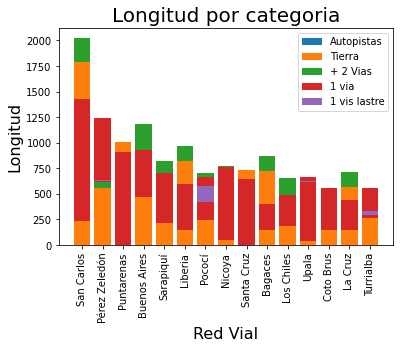

In [ ]:
# Graficación

Cantones = chart_1['cantones']
autopistas = chart_1['AUTOPISTA']
tierra = chart_1['CAMINO DE TIERRA']
dos_vias = chart_1['CARRETERA PAVIMENTO DOS VIAS O MAS']
una_via = chart_1['CARRETERA PAVIMENTO UNA VIA']
dos_via_lastre = chart_1['CARRETERA SIN PAVIMENTO DOS VIAS']

plt.bar(Cantones, autopistas)
plt.bar(Cantones, tierra, bottom=autopistas)
plt.bar(Cantones, dos_vias, bottom=tierra)
plt.bar(Cantones, una_via, bottom=dos_vias)
plt.bar(Cantones, dos_via_lastre, bottom=una_via)

plt.title('Longitud por categoria', fontsize=20)
plt.xlabel('Red Vial', fontsize=16)
plt.ylabel('Longitud', fontsize=16)
#plt.xticks(Cantones, chart_1.index)
plt.xticks(rotation=90)
plt.legend(['Autopistas','Tierra','+ 2 Vias','1 via', '1 vis lastre'])
plt.show()


In [ ]:
rows = chart_1.index
chart_3.drop(rows, inplace=True)

In [ ]:
longitud_right = chart_3.agg(x=('longitud_right', sum))

In [ ]:
chart_2 = chart_1.copy()

In [ ]:
new_row = ({'longitud_right': longitud_right.iloc[0,0], 'cantones':'Otros Cantones'})

In [ ]:
row_df = pd.DataFrame([new_row], index = ["Otros"])
chart_2 = pd.concat([row_df, chart_2])
chart_2 = chart_2.fillna(0)
chart_2

,longitud_right,cantones,AUTOPISTA,CAMINO DE TIERRA,CARRETERA PAVIMENTO DOS VIAS O MAS,CARRETERA PAVIMENTO UNA VIA,CARRETERA SIN PAVIMENTO DOS VIAS
Otros,28340.781761,Otros Cantones,0.0,0.000000,0.000000,0.000000,0.000000
San Carlos,4709.597293,San Carlos,0.0,1788.434587,235.255780,1188.804126,0.000000
Pérez Zeledón,2593.591094,Pérez Zeledón,0.0,554.948076,614.239576,622.699689,14.918528
Puntarenas,2484.825234,Puntarenas,0.0,1002.213502,0.000000,912.237824,0.000000
Buenos Aires,2352.440919,Buenos Aires,0.0,719.950947,466.745572,466.150065,0.000000
Sarapiquí,2004.959224,Sarapiquí,0.0,606.571503,215.274422,490.711492,0.000000
Liberia,1945.520518,Liberia,0.0,818.180074,145.773959,452.383075,0.000000
Pococí,1922.083166,Pococí,0.0,463.454028,243.316634,418.537968,159.901025
Nicoya,1784.094035,Nicoya,0.0,720.327993,49.109390,711.836786,0.000000
Santa Cruz,1752.602017,Santa Cruz,0.0,732.618033,0.000000,641.996782,0.000000


In [ ]:
sizes = chart_2['longitud_right']
Cantones = chart_2['cantones']

# 3. Gráfica Pastel

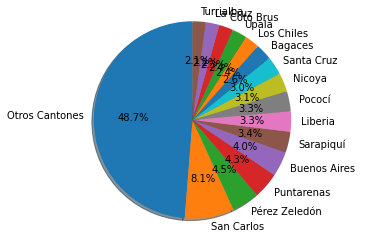

In [ ]:
# Pie chart, where the slices will be ordered and plotted counter-clockwise:
labels = Cantones
sizes = sizes
#explode = (0, 0.1, 0, 0)  # only "explode" the 2nd slice (i.e. 'Hogs')

fig1, ax1 = plt.subplots()
ax1.pie(sizes,  labels=labels, autopct='%1.1f%%',
        shadow=True, startangle=90)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.show()

# 4. Mapa

In [ ]:
# Creación del mapa base
m = folium.Map(location=[9.8, -84], tiles='CartoDB positron', zoom_start=8)

folium.Choropleth(
    name="Cantidad de especies en ASP",
    geo_data=RedVial,
    data=Mapa,
    columns=['canton', 'densidad'],
    bins=8,
    key_on='feature.properties.canton',
    fill_color='Reds', 
    fill_opacity=0.5, 
    line_opacity=1,
    legend_name='Densidad vial Cantonal',
    smooth_factor=0).add_to(m)

# Control de capas
folium.LayerControl().add_to(m)

# Despliegue del mapa
m